## Прогнозирование температуры звезды<br>

Пришла задача от обсерватории «Небо на ладони»: придумать, как с помощью нейросети определять температуру на поверхности обнаруженных звёзд.<br> 
Обычно для расчёта температуры учёные пользуются следующими методами: <br>
- Закон смещения Вина.
- Закон Стефана-Больцмана.
- Спектральный анализ.

Каждый из них имеет плюсы и минусы. Обсерватория хочет внедрить технологии машинного обучения для предсказания температуры звёзд, надеясь, что этот метод будет наиболее точным и удобным. <br>
В базе обсерватории есть характеристики уже изученных 240 звёзд.<br>
Характеристики:
- Относительная светимость L/Lo — светимость звезды относительно Солнца.
- Относительный радиус R/Ro — радиус звезды относительно радиуса Солнца.
- Абсолютная звёздная величина Mv — физическая величина, характеризующая блеск звезды.
- Звёздный цвет (white, red, blue, yellow, yellow-orange и др.) — цвет звезды, который определяют на основе спектрального анализа.
- Тип звезды.

## Загрузка данных

In [1]:
!pip install ydata_profiling

In [2]:
!pip install skorch

In [3]:
import pandas as pd
from ydata_profiling import ProfileReport
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
from torch import optim
import torch
import torch.nn as nn
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
import numpy as np
from sklearn.compose import ColumnTransformer
import phik
from phik.report import plot_correlation_matrix
from phik import report
torch.use_deterministic_algorithms(True)
import math
from sklearn.metrics import mean_squared_error
from sklearn.metrics import make_scorer
from skorch.callbacks import EpochScoring, EarlyStopping
from skorch.dataset import ValidSplit 

from skorch import NeuralNetRegressor

from sklearn.metrics import make_scorer
from sklearn.metrics import mean_squared_error

from sklearn.model_selection import cross_val_score, RandomizedSearchCV


In [4]:
torch.manual_seed(12345)

In [5]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))

In [6]:

df = pd.read_csv('https://code.s3.yandex.net/datasets/6_class.csv', index_col='Unnamed: 0') 


In [7]:
df

,Temperature (K),Luminosity(L/Lo),Radius(R/Ro),Absolute magnitude(Mv),Star type,Star color
0,3068,0.002400,0.1700,16.12,0,Red
1,3042,0.000500,0.1542,16.60,0,Red
2,2600,0.000300,0.1020,18.70,0,Red
3,2800,0.000200,0.1600,16.65,0,Red
4,1939,0.000138,0.1030,20.06,0,Red
...,...,...,...,...,...,...
235,38940,374830.000000,1356.0000,-9.93,5,Blue
236,30839,834042.000000,1194.0000,-10.63,5,Blue
237,8829,537493.000000,1423.0000,-10.73,5,White
238,9235,404940.000000,1112.0000,-11.23,5,White


In [8]:
profile = ProfileReport(df, title="Profiling Report")

Явных дупликатов нет, пропущенных значений также нет. Это уже радует, данные подготовлены, не сырые. <br>
Детально далее нужно будет пройтись по каждому столбцу, построим графики и почистим выбросы, если такие имеются. 

Также видны высокие корреляции, что очень логично. И алерт о том, что тип звезд имеет 40 нулей. <br>
В нашем случае ноль - это конкретный тип звезды (коричневый карлик). 

## Предобработка и анализ данных

In [10]:
df

,Temperature (K),Luminosity(L/Lo),Radius(R/Ro),Absolute magnitude(Mv),Star type,Star color
0,3068,0.002400,0.1700,16.12,0,Red
1,3042,0.000500,0.1542,16.60,0,Red
2,2600,0.000300,0.1020,18.70,0,Red
3,2800,0.000200,0.1600,16.65,0,Red
4,1939,0.000138,0.1030,20.06,0,Red
...,...,...,...,...,...,...
235,38940,374830.000000,1356.0000,-9.93,5,Blue
236,30839,834042.000000,1194.0000,-10.63,5,Blue
237,8829,537493.000000,1423.0000,-10.73,5,White
238,9235,404940.000000,1112.0000,-11.23,5,White


В нашем распоряжении 240 различных звёзд, у них есть 4 количественных характеристик и 2 категориальные (если учитывать цвет как категориальный параметр)

Температура будет в будущем целевым таргетом и именно по ней будем считать ошибку будущей нейросети. <br>
Перед нами стоит задача регрессии. 

In [11]:
for column in df.columns:
    print(column)
    print(df[column].unique())

Temperature (K)
[ 3068  3042  2600  2800  1939  2840  2637  2650  2700  3600  3129  3134
  3628  3340  2799  3692  3192  3441 25000  7740  7220  8500 16500 12990
  8570  7700 11790  7230 39000 30000 15276  9700  5800  8052  6757  6380
  5936  5587  3826  3365  3270  3200  3008  3575  3574  3625 33750  3490
  3750  3834  3749  3650  3450  3660  3752  3535  3341  3432  2983  2835
  2935  3295  2945  2817  2774  2871  3345  3607  3304  3150  3550  3180
  2890  3342  2621  3158  7100 10574  8930 17200 14100  9675 12010 10980
 13720 19860  5300  4526  4077  4980  9030 11250  5112  7720 12098 36108
 33300 40000 23000 17120 11096 14245 24630 12893 24345 33421  3459  3605
  3615  3399  3610  3553  4015  6850  3780  3323  3531  3218  3146  3511
  3225  2861  2856  2731  3095  3100  2989  3542  3243  3091  3598  3324
  3541 13420 21020 18290 14520 11900  8924 12912 14732  7723 12984 29560
  8945 14060 16390 25070 28700 26140 20120 13023 37800 25390 11567 12675
  5752  8927  7282 19923 26373 1738

Есть названия цветов, которые повторяются

In [12]:
#устраним неявные дупликаты
df['Star color'] = df['Star color'].replace(['yellow-white', 'yellowish white'], 'white-yellow')
df['Star color'] = df['Star color'].replace('blue white', 'blue-white')
df['Star color'] = df['Star color'].replace('whitish', 'white')
df['Star color'] = df['Star color'].str.lower()
df['Star color'] = df['Star color'].str.strip(to_strip = None)

Сперва посмотрим на графики количественных характеристик. Далее рассмотрим и категориальные.

In [13]:
sns.set(rc={'figure.figsize':(20, 8)})

In [14]:
df.columns

Index(['Temperature (K)', 'Luminosity(L/Lo)', 'Radius(R/Ro)',
       'Absolute magnitude(Mv)', 'Star type', 'Star color'],
      dtype='object')

In [15]:
df_value = ['Temperature (K)', 'Luminosity(L/Lo)', 'Radius(R/Ro)',
       'Absolute magnitude(Mv)']

In [16]:
#устраним неявные дупликаты
df['Star color'] = df['Star color'].replace('blue white', 'blue-white')
df['Star color'] = df['Star color'].replace(['yellow-white', 'yellowish white'], 'white-yellow')
df['Star color'] = df['Star color'].str.lower()
df['Star color'] = df['Star color'].str.strip(to_strip = None)

In [17]:
def graphs(dataset):
    for column in df[df_value]:
        fig, ax = plt.subplots(1, 2)

        sns.histplot(dataset[column], ax=ax[0], color='blue', kde=True)
        ax[0].set_title('Распределение столбца \'{}\' датасета - \'df\''.format(column))

        sns.violinplot(dataset[column], ax=ax[1], color='orange')
        ax[1].set_title('Violinplot для \'{}\'  датасета - \'df\''.format(column))

        plt.show()

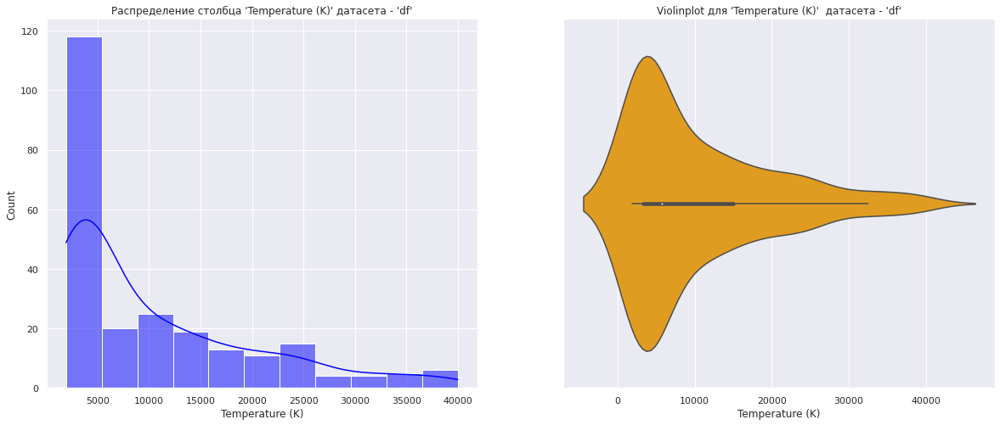

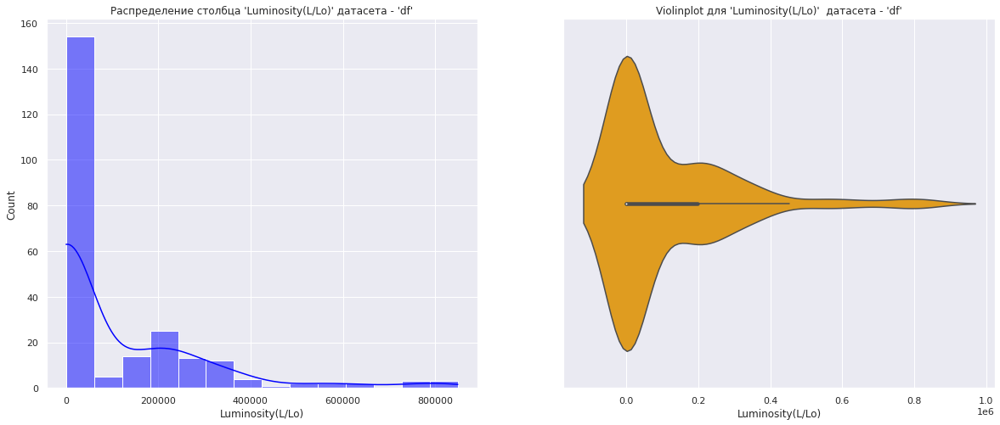

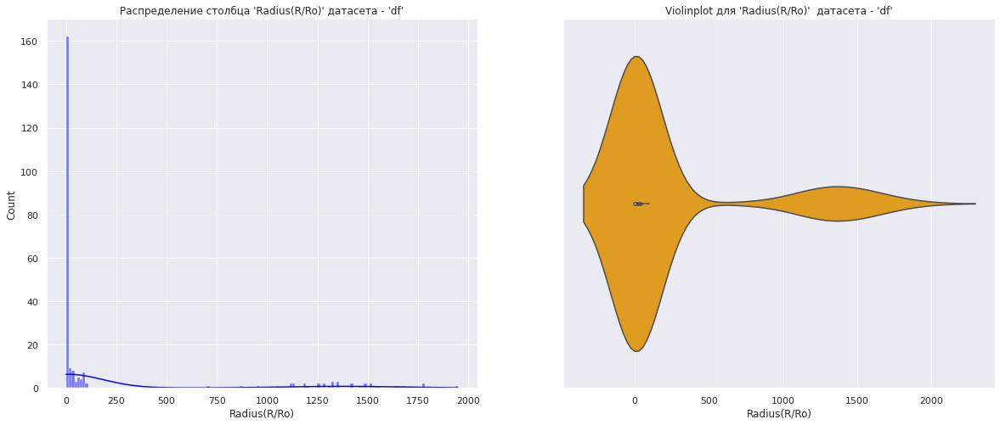

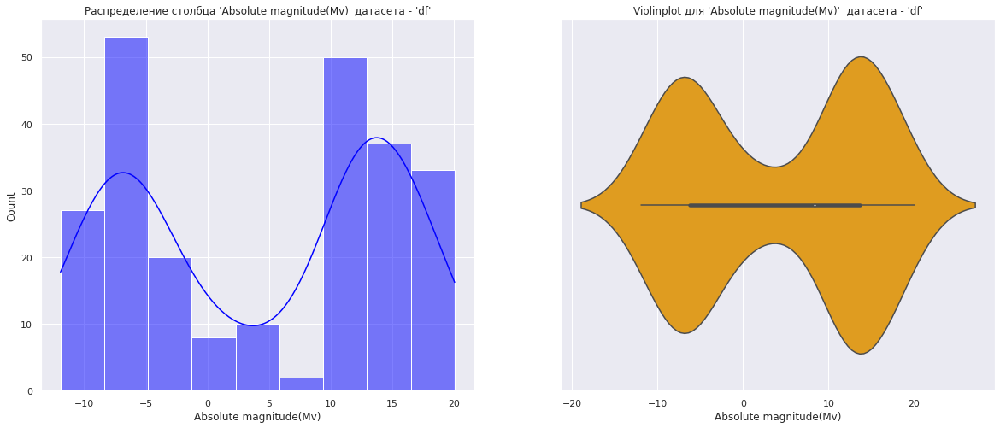

In [18]:
graphs(df)

Что можно подметить в самом начале исследования?<br>
- - - 
**Температура** <br>
Температура звёзд в большинстве своём до 10к кельвинов, но есть и более горячие звёзды. И их также много. <br>
Минимальное значение (из профайла) -  1939K, 
А максимальное - 40к К
- - - 
Т.к. светимость и радиус относительные, (относительно Солнца) мы должны будем вывести справочные значения параметров Солнца далее.<br>
- - - 
**Справочная информация**: <br>
- Светимость Солнца (англ. Average Luminosity of Sun): <br>
$L_{0} = 3.828⋅10^{26}Вт$	

- Радиус Солнца (англ. Average Radius of Sun): <br>
$R_{0} = 6.9551* 10^{8}м$
- - - 
**Относительная светимость L/Lo** <br>
Мы видим, что есть значения 8 × 10^^-5 в качестве минимального и  849420 в качестве максимального. <br>
Благодаря графику этому мы видим, что Солнце - яркая звезда и множество звёзд менее яркие относительно Солнца. 
- - - 
**Относительный радиус R/Ro** <br>
А здесь же ситуация обратная и мы видим, что большое кол-во звёзд есть больше светила нашей системы. <br>
Минимальное значение - 0.0084, а максимальное - 1948.5 <br>
Если смотреть на вайолин плот, то видно, что Солнце - звёзда, имеющая медианный (примерно) радиус.  

- - - 
**Абсолютная звёздная величина Mv** <br>
Блеск наблюдаемых наших звёзд в диапазоне: от -11.92 (минимум) и до 20.06 (максимум)<br> 
Чуть меньше половины звёзд (102) имеет блеск меньше нуля. 

In [19]:
lum_sun = 3.828 * 10**26
rad_sun = 6.9551 * 10**8

In [20]:
#Проверил изменятся ли результаты, если переводиться в абсолютные величины из относительных. Но как и думал, ничего не изменилось
#df['Radius(R/Ro)'] = df['Radius(R/Ro)'] * rad_sun
#df['Luminosity(L/Lo)'] = df['Luminosity(L/Lo)'] * lum_sun

Далее построим графики по оставшимся категориальным столбцам. 

In [21]:
df_cat = ['Star type', 'Star color']

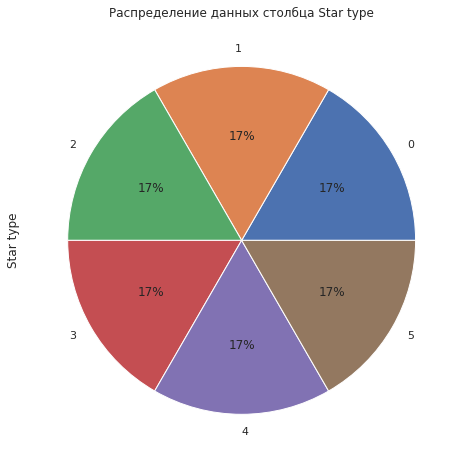

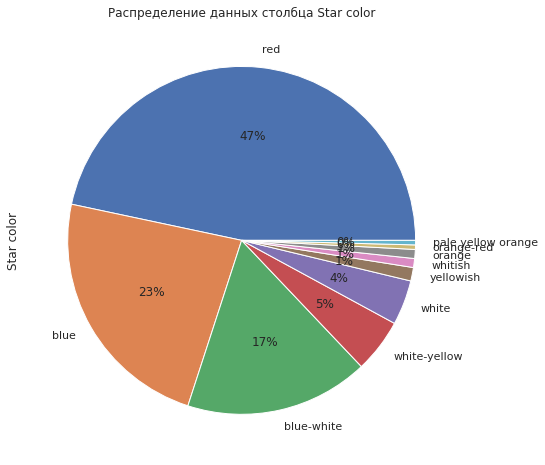

In [22]:
for column in df[df_cat]:
    df[column].value_counts()[:10].plot.pie(autopct='%1.0f%%').set_title('Распределение данных столбца {}'.format(column))
    plt.show()

**Тип звезды**<br>
В нашем датасете по типу звезды данные распределенны равномерно
- - -
**Цвет звезды** <br>
Красных звёзд больше всего, далее голубые и голубо-белые. 

In [23]:
sns.set(rc={'figure.figsize':(30, 15)})

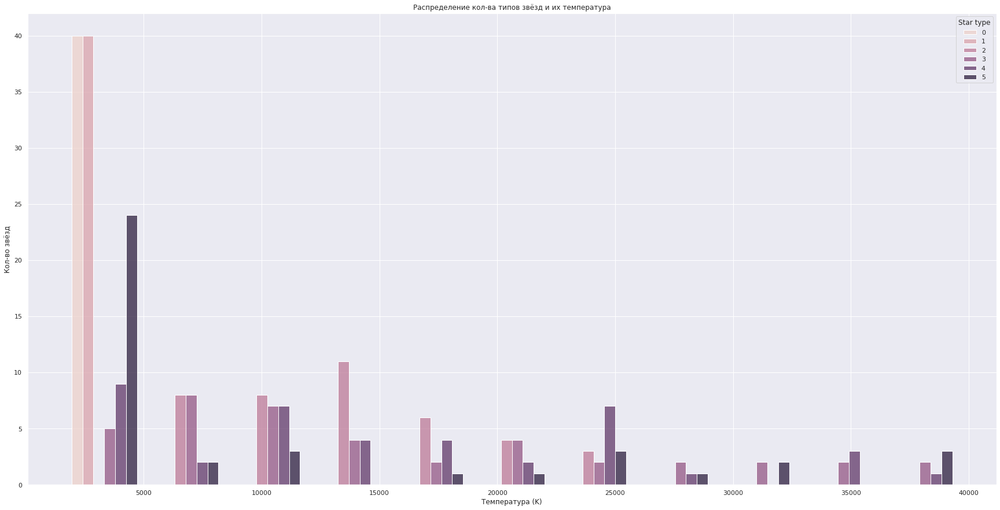

In [24]:
sns.histplot(df,x= 'Temperature (K)', hue= 'Star type', multiple="dodge", shrink=.8)
plt.title('Распределение кол-ва типов звёзд и их температура')
plt.ylabel('Кол-во звёзд')
plt.xlabel('Температура (K)')
plt.show()

Более заметно на этом графике, что температура звёзд-карликов минимальная среди звёзд. <br>
Хотя мы это и понимали и без этого графика.

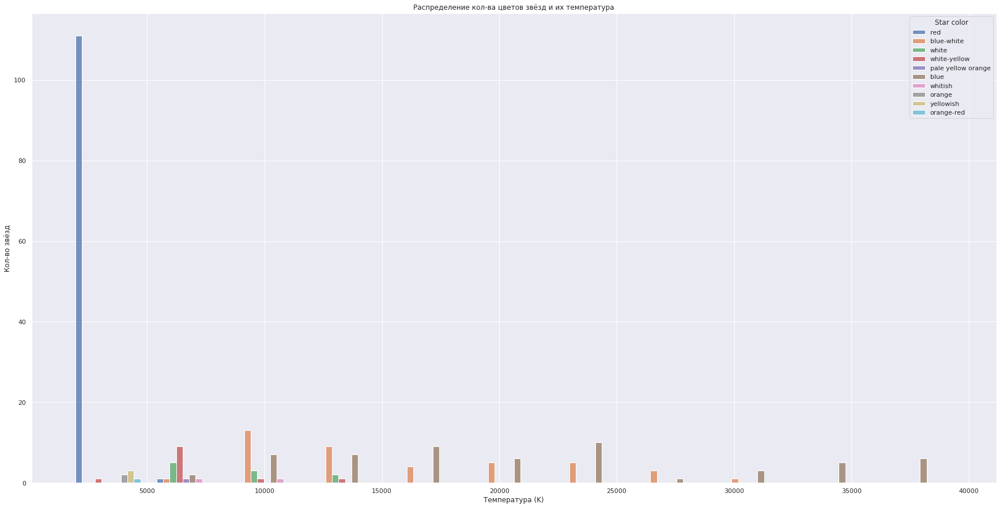

In [25]:
sns.histplot(df,x= 'Temperature (K)', hue= 'Star color', multiple="dodge", shrink=.8)
plt.title('Распределение кол-ва цветов звёзд и их температура')
plt.ylabel('Кол-во звёзд')
plt.xlabel('Температура (K)')
plt.show()

Не стал заморачиваться с одинаковым отображением цвета (фактическое в тексте = реальное на графике), но в рамках дальнейшего улучшения, это можно осуществить. 

По самой низкой температуре видно, что звёзды красного цвета имеют минимальную температуру. 

Думаю, можно сделать такие графики для всех остальных численных столбцов. Вдруг, увижу еще какие интересные моменты.

In [26]:
def graphs_group(dataset):
    for column in df[df_value1]:
        fig, ax = plt.subplots(1, 2)

        sns.histplot(dataset, x= dataset[column], ax=ax[0], hue= 'Star type', multiple="dodge", shrink=.8)
        ax[0].set_title('Распределение столбца \'{}\' с привязкой к столбцу типа звезды '.format(column))

        sns.histplot(dataset, x= dataset[column], ax=ax[1], hue= 'Star color', multiple="dodge", shrink=.8)
        ax[1].set_title('Распределение столбца \'{}\' с привязкой к столбцу цвета звезды '.format(column))

        plt.show()

In [27]:
df_value1 = [ 'Luminosity(L/Lo)', 'Radius(R/Ro)',
       'Absolute magnitude(Mv)']

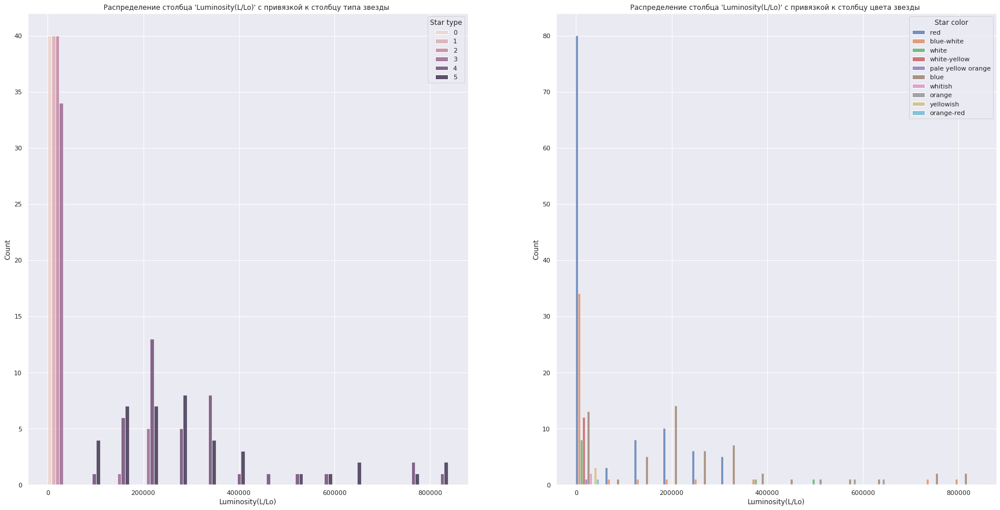

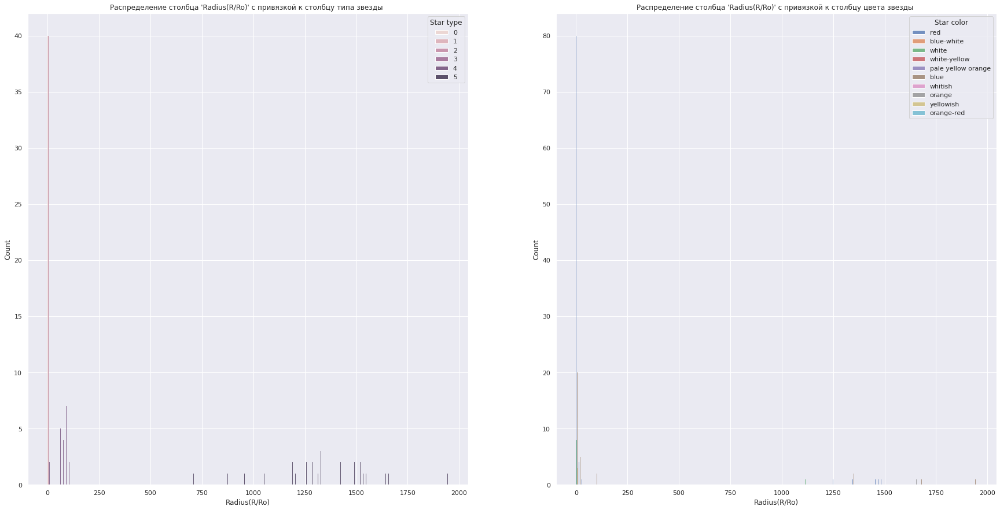

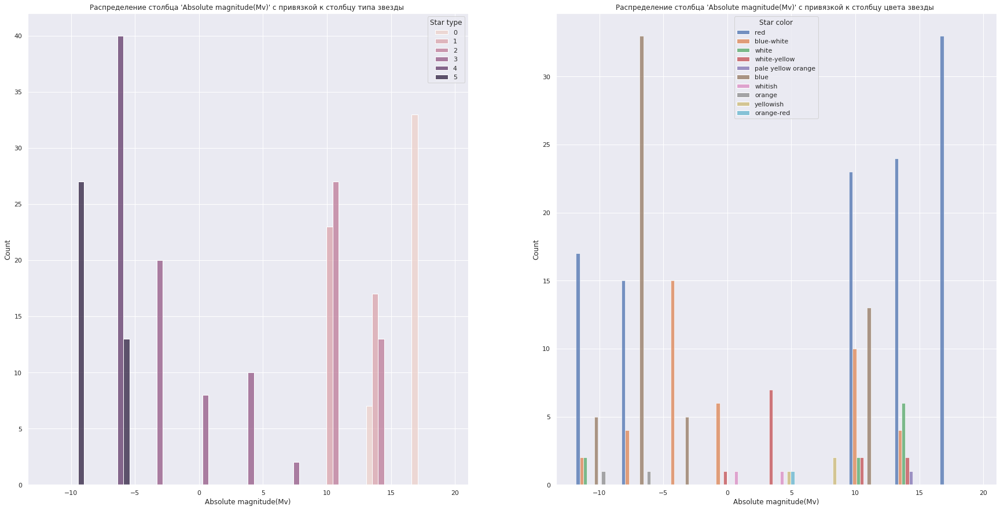

In [28]:
graphs_group(df)

**Относительная светимость L/Lo** <br>
Что и с температурой, то и со светимостью относительной, самые малояркие - карлики.
- - - 
**Относительный радиус R/Ro** <br>
По радиусу проблема в отображении графика. <br>
Нужно преобразовать в абсолютные значения, скорее всего.. <br>
Или же перерисовывать индивидуально 
- - - 
**Абсолютная звёздная величина Mv** <br>
А вот блеск по магнитуде у карликов выше.

Подумал и решил, что вероятнее всего преобразование в абсолютные значения никак изменит ситуацию и для нейронной сети не будет разницы. <br>
Пока оставлю так, а далее протестирую оба варианта. 

Также, появилось желание протестировать улучшения/ухудшения результатов метрики предикта нейронной сети при замене некоторых численных характеристик на категоризированные. 

In [29]:
colors = sns.color_palette("Paired")
sns.set(rc={'figure.figsize':(20, 8)}, palette=colors)

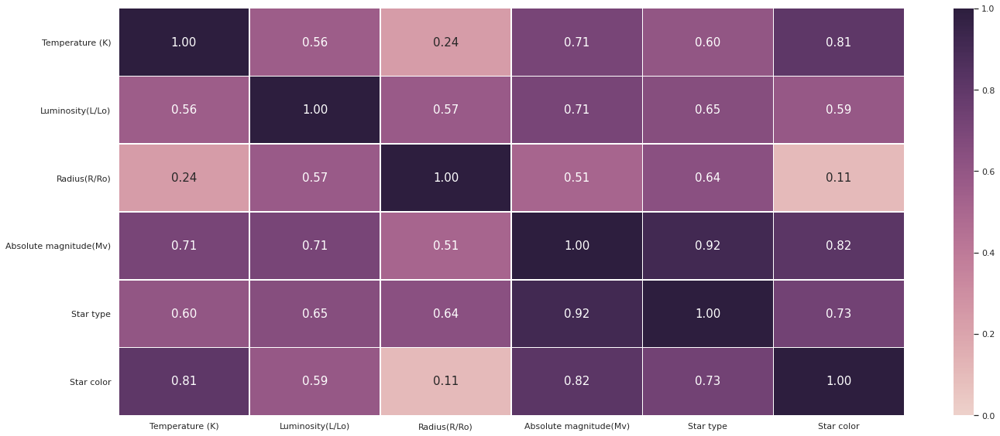

In [30]:
phik_overview = df.phik_matrix(interval_cols= df[df_value])
phik_overview.round(2)
sns.heatmap(phik_overview,
                        vmin=0, vmax=1,
                    annot = True,
                annot_kws = {"size":15},
                cmap=sns.cubehelix_palette(as_cmap=True),
                fmt='.2f',  linewidth=.5)
plt.tight_layout()

Видна высокая корреляция от типа звезды к блеску (абсолютной магнитуде). <br>
А также высокая корреляция от типа звезды к цвету (но это супер логично). <br>


In [31]:
sns.set(rc={'figure.figsize':(5, 8)})

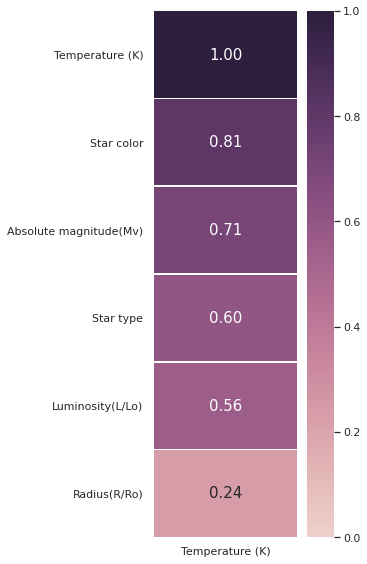

In [32]:
sns.heatmap(phik_overview.sort_values(by = 'Temperature (K)', ascending=False)[['Temperature (K)']],
                        vmin=0, vmax=1,
                    annot = True,
                annot_kws = {"size":15},
                cmap=sns.cubehelix_palette(as_cmap=True),
                fmt='.2f',  linewidth=.5)
plt.tight_layout()

Смотря на корреляцию конкретно по целевому таргету, то видим, что тип звезды и блеск весьма сильно коррелирует с температурой. 

- - -

Преобразуем данные

In [33]:
X_train, X_test, y_train, y_test = train_test_split(df.drop('Temperature (K)', axis = 1),
                                                    df['Temperature (K)'],
                                                    test_size=0.3,
                                                    shuffle=True,
                                                    random_state=12345)
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(168, 5) (72, 5) (168,) (72,)


In [34]:
num = ['Luminosity(L/Lo)','Radius(R/Ro)','Absolute magnitude(Mv)']
cat = ['Star color', 'Star type']

column_transformer = ColumnTransformer(
                        transformers=[
                            ('scaler', StandardScaler(), num),
                            ('ohe', OneHotEncoder(sparse=False), cat)],
                                remainder="passthrough")

column_transformer.fit(df.drop('Temperature (K)', axis=1))
X_train = column_transformer.transform(X_train)
X_test = column_transformer.transform(X_test)

Данные преобразованы и поделены на выборки

## Построение базовой нейронной сети

Создадим тензоры из разделенных данных для обучения нейронной сети

In [35]:
X_train = torch.FloatTensor(np.array(X_train))
X_test = torch.FloatTensor(np.array(X_test))
y_train = torch.FloatTensor(np.array(y_train))
y_test = torch.FloatTensor(np.array(y_test))

In [36]:
class Net(nn.Module):
    def __init__(self, n_in_neurons, n_hidden_neurons_1, n_hidden_neurons_2, n_out_neurons):
        super(Net, self).__init__()  
        self.fc1= nn.Linear(n_in_neurons,n_hidden_neurons_1)
        self.fc2= nn.Linear(n_hidden_neurons_1,n_hidden_neurons_2)
        self.fc3= nn.Linear(n_hidden_neurons_2,n_out_neurons)
        self.relu = nn.ReLU()
        self.flatten = nn.Flatten(start_dim=0)
    def forward(self,x):
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        x = self.relu(x)
        x = self.fc3(x)
        return self.flatten(x)

In [37]:
X_train[0].size()[0]

19

In [38]:
n_in_neurons = X_train[0].size()[0]
n_hidden_neurons_1 = 15
n_hidden_neurons_2 = 10
n_out_neurons = 1 

In [39]:
n_in_neurons

19

In [40]:
net = Net(n_in_neurons, n_hidden_neurons_1, n_hidden_neurons_2, n_out_neurons)
optimizer = torch.optim.Adam(net.parameters(), lr=1e-3)

loss =  nn.MSELoss()

num_epochs = 10000

In [41]:
def rmse(y_true, y_pred):
    return mean_squared_error(y_true, y_pred, squared=False)

rmse_scorer = make_scorer(rmse)  

In [42]:
best_rmse = float('inf')

for epoch in range(num_epochs):
    optimizer.zero_grad()
    
    preds = net.forward(X_train)
    RMSE_loss = torch.sqrt(loss(preds, y_train))
    RMSE_loss.backward()
    optimizer.step()
    
    if epoch % 100 == 0 or epoch == num_epochs - 1:
        net.eval()
        test_preds = net.forward(X_test)
        rmse = torch.sqrt(torch.mean((test_preds - y_test)**2))
        print(rmse)
        if rmse < best_rmse:
            best_rmse = rmse
if best_rmse != float('inf'):
    print("Лучшая тестовая метрика RMSE:", best_rmse)

tensor(15520.7012, grad_fn=<SqrtBackward0>)
tensor(15519.7812, grad_fn=<SqrtBackward0>)
tensor(15513.7676, grad_fn=<SqrtBackward0>)
tensor(15494.2881, grad_fn=<SqrtBackward0>)
tensor(15453.2402, grad_fn=<SqrtBackward0>)
tensor(15383.9990, grad_fn=<SqrtBackward0>)
tensor(15280.6426, grad_fn=<SqrtBackward0>)
tensor(15139.4863, grad_fn=<SqrtBackward0>)
tensor(14958.0488, grad_fn=<SqrtBackward0>)
tensor(14735.2441, grad_fn=<SqrtBackward0>)
tensor(14471.4531, grad_fn=<SqrtBackward0>)
tensor(14168.0508, grad_fn=<SqrtBackward0>)
tensor(13826.5039, grad_fn=<SqrtBackward0>)
tensor(13448.7588, grad_fn=<SqrtBackward0>)
tensor(13037.7842, grad_fn=<SqrtBackward0>)
tensor(12598.4131, grad_fn=<SqrtBackward0>)
tensor(12138.4932, grad_fn=<SqrtBackward0>)
tensor(11666.1816, grad_fn=<SqrtBackward0>)
tensor(11189.9482, grad_fn=<SqrtBackward0>)
tensor(10718.8418, grad_fn=<SqrtBackward0>)
tensor(10261.5840, grad_fn=<SqrtBackward0>)
tensor(9825.9326, grad_fn=<SqrtBackward0>)
tensor(9418.4189, grad_fn=<SqrtBa

Далее мы будем стараться улучшить этот показатель в следующем разделе проекта. 

## Улучшение нейронной сети

In [43]:
params = {
    'module__dropout_1': [0, 0.1, .3, .5, .7],
    'module__dropout_2': [0, 0.1, .3, .5, .7],
    'module__n_hidden_neurons_1': [15],
    'module__n_hidden_neurons_2': [10],
    'module__activation_1': [nn.ReLU(), nn.ReLU()],
    'module__activation_2': [nn.ReLU(), nn.ReLU()],
    'module__n_in_neurons': [X_train[0].size()[0]],
    'module__n_out_neurons': [1],
    'batch_size': [10,20,40,100]

}    

In [44]:
class Model_improve(nn.Module):
    def __init__(self, n_in_neurons, n_hidden_neurons_1, n_hidden_neurons_2, n_out_neurons, 
                 dropout_1, dropout_2, activation_1, activation_2):
        super(Model_improve, self).__init__()

        self.fc1 = nn.Linear(n_in_neurons, n_hidden_neurons_1) 
        self.a1 = activation_1
        self.drop1 = nn.Dropout(dropout_1)

        self.fc2 = nn.Linear(n_hidden_neurons_1, n_hidden_neurons_2)
        self.a2 = activation_2
        self.drop2 = nn.Dropout(dropout_2)

        self.fc3 = nn.Linear(n_hidden_neurons_2, n_out_neurons)
        self.flatten = nn.Flatten(start_dim=0)
    def forward(self, x):
        x = self.fc1(x)
        x = self.a1(x)
        x = self.drop1(x)
        x = self.fc2(x)
        x = self.a2(x)
        x = self.drop2(x)
        x = self.fc3(x)
        return self.flatten(x)

In [45]:
patience = 60

In [46]:
from skorch.callbacks import EpochScoring, EarlyStopping
skorch_regressor = NeuralNetRegressor(module=Model_improve, 
                                      device='cpu',  
                                      verbose=0,
                                      batch_size=32,
                                      optimizer=torch.optim.Adam,
                                      optimizer__lr= 1e-3, 
                                      max_epochs=40000, 
                                      lr=1e-3,
                                      train_split=ValidSplit(cv=5),
                                      criterion =nn.MSELoss,
                                      callbacks=[
                ('val_rmse', EpochScoring(scoring=rmse_scorer, lower_is_better=True, name='RMSE')),
                ('estoper', EarlyStopping( lower_is_better=True, monitor='RMSE', patience=patience)),
            ]
                                     ) 

In [47]:
grid = RandomizedSearchCV(skorch_regressor, params, n_jobs=-1, cv=3, scoring="neg_root_mean_squared_error", verbose=0) 
grid.fit(X_train, y_train.reshape(-1,1)) 

/opt/conda/lib/python3.9/site-packages/torch/nn/modules/loss.py:520: UserWarning: Using a target size (torch.Size([20, 1])) that is different to the input size (torch.Size([20])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/opt/conda/lib/python3.9/site-packages/torch/nn/modules/loss.py:520: UserWarning: Using a target size (torch.Size([9, 1])) that is different to the input size (torch.Size([9])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/opt/conda/lib/python3.9/site-packages/torch/nn/modules/loss.py:520: UserWarning: Using a target size (torch.Size([3, 1])) that is different to the input size (torch.Size([3])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target

RandomizedSearchCV(cv=3,
                   estimator=<class 'skorch.regressor.NeuralNetRegressor'>[uninitialized](
  module=<class '__main__.Model_improve'>,
),
                   n_jobs=-1,
                   param_distributions={'batch_size': [10, 20, 40, 100],
                                        'module__activation_1': [ReLU(),
                                                                 ReLU()],
                                        'module__activation_2': [ReLU(),
                                                                 ReLU()],
                                        'module__dropout_1': [0, 0.1, 0.3, 0.5,
                                                              0.7],
                                        'module__dropout_2': [0, 0.1, 0.3, 0.5,
                                                              0.7],
                                        'module__n_hidden_neurons_1': [15],
                                        'module__n_hidden_neurons_2':

In [48]:
grid.best_params_

{'module__n_out_neurons': 1,
 'module__n_in_neurons': 19,
 'module__n_hidden_neurons_2': 10,
 'module__n_hidden_neurons_1': 15,
 'module__dropout_2': 0.1,
 'module__dropout_1': 0,
 'module__activation_2': ReLU(),
 'module__activation_1': ReLU(),
 'batch_size': 10}

In [49]:
grid.best_score_

-8756.471842447916

In [50]:
pd.DataFrame(grid.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_module__n_out_neurons,param_module__n_in_neurons,param_module__n_hidden_neurons_2,param_module__n_hidden_neurons_1,param_module__dropout_2,param_module__dropout_1,param_module__activation_2,param_module__activation_1,param_batch_size,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,10.987692,2.089446,0.002154,0.000148,1,19,10,15,0.1,0,ReLU(),ReLU(),20,"{'module__n_out_neurons': 1, 'module__n_in_neu...",-7323.247559,-10062.277344,-9459.397461,-8948.307454,1175.154114,4
1,11.577766,3.032584,0.001647,0.000083,1,19,10,15,0.7,0,ReLU(),ReLU(),40,"{'module__n_out_neurons': 1, 'module__n_in_neu...",-7145.989746,-11057.988281,-10012.864258,-9405.614095,1653.783078,8
2,12.447567,1.705209,0.002036,0.000547,1,19,10,15,0.1,0.5,ReLU(),ReLU(),40,"{'module__n_out_neurons': 1, 'module__n_in_neu...",-7129.293457,-10410.025391,-9464.417969,-9001.245605,1378.815188,6
3,10.401765,1.582308,0.001991,0.000090,1,19,10,15,0.1,0.3,ReLU(),ReLU(),20,"{'module__n_out_neurons': 1, 'module__n_in_neu...",-7239.724121,-10088.286133,-9451.995117,-8926.668457,1220.806416,2
4,11.621168,1.315494,0.002689,0.000194,1,19,10,15,0.1,0,ReLU(),ReLU(),10,"{'module__n_out_neurons': 1, 'module__n_in_neu...",-7077.099121,-9885.883789,-9306.432617,-8756.471842,1210.829046,1
5,11.898390,1.611937,0.002587,0.001003,1,19,10,15,0.3,0.1,ReLU(),ReLU(),20,"{'module__n_out_neurons': 1, 'module__n_in_neu...",-7164.435059,-10254.257812,-9484.856445,-8967.849772,1313.322273,5
6,12.100774,2.003646,0.001886,0.000294,1,19,10,15,0.3,0.5,ReLU(),ReLU(),40,"{'module__n_out_neurons': 1, 'module__n_in_neu...",-7109.294922,-10527.900391,-9455.129883,-9030.775065,1427.532509,7
7,1.022924,0.034042,0.001562,0.000198,1,19,10,15,0.3,0.7,ReLU(),ReLU(),100,"{'module__n_out_neurons': 1, 'module__n_in_neu...",-11083.298828,-15213.839844,-14059.567383,-13452.235352,1740.111379,10
8,0.824570,0.019680,0.002757,0.001002,1,19,10,15,0,0.7,ReLU(),ReLU(),100,"{'module__n_out_neurons': 1, 'module__n_in_neu...",-11083.494141,-15213.403320,-14059.320312,-13452.072591,1739.846699,9
9,11.917832,2.894922,0.002055,0.000110,1,19,10,15,0,0.5,ReLU(),ReLU(),20,"{'module__n_out_neurons': 1, 'module__n_in_neu...",-7169.725586,-10206.144531,-9405.000000,-8926.956706,1284.874584,3


Гридсерчем сперва выявил сколько нейронов в скрытых слоях оставить, оказались 15 и 10 на первом и втором слоях соответственно. <br>
Далее методом перебора выявили, что batch_size повышает качество метрики, если брать параметр этот ниже. Даже в таком датасете, где всего 240 строк - этот параметр улучшает метрику. <br>
А также выявили, что dropout не требуется ставить большое значение. И лучший результат достигается при дропауте на втором слое со значением .1

Далее будем использовать batch именно по 10 элементов. Он оказался лучшим. <br>
А оптимизатор будем использовать NAdam <br>
В дальнейшем будем пробовать играться с регуляризацией. 


- - - 

Лучший результат показала модель, в которой перед скрытым слоем стоит инструмент регуляризации Dropout. <br>
Её сохраним. 

In [73]:
class Net(nn.Module):
    def __init__(self, n_in_neurons, n_hidden_neurons_1, n_hidden_neurons_2, n_out_neurons, 
                 dropout_2): 
        super(Net, self).__init__()  
        self.fc1= nn.Linear(n_in_neurons,n_hidden_neurons_1)
        self.fc2= nn.Linear(n_hidden_neurons_1,n_hidden_neurons_2)
        self.relu = nn.ReLU()
        self.fc3= nn.Linear(n_hidden_neurons_2,n_out_neurons)
        self.drop2 = nn.Dropout(dropout_2)
        self.flatten = nn.Flatten(start_dim=0)
    def forward(self,x):
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        x = self.relu(x)
        x = self.drop2(x)
        x = self.fc3(x)
        return self.flatten(x)

In [74]:
dropout_2 = 0

In [75]:
net = Net(n_in_neurons, n_hidden_neurons_1, n_hidden_neurons_2, n_out_neurons, dropout_2)
optimizer = torch.optim.NAdam(net.parameters(), lr=1e-3)

loss =  nn.MSELoss()

In [76]:
class EarlyStopping:
    def __init__(self, patience=60, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False

    def __call__(self, val_loss):
        if self.best_loss is None:
            self.best_loss = val_loss
        elif self.best_loss - val_loss > self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
        elif self.best_loss - val_loss < self.min_delta:
            self.counter += 1
            print(f"EarlyStopping counter: {self.counter} out of {self.patience}")
            if self.counter >= self.patience:
                print('Early stopping')
                self.early_stop = True

In [78]:
patience = 60
early_stopping = EarlyStopping(patience=patience, min_delta=0)
batch_size = 10
num_epochs = 100001
num_batches = math.ceil(len(X_train)/batch_size)
for epoch in range(num_epochs):
    net.train()
    order = np.random.permutation(len(X_train)) # создайте случайную перестановку индексов объектов
    for batch_idx in range(num_batches):
        start_index = batch_idx * batch_size # посчитайте номер стартового объекта батча
        optimizer.zero_grad()
  
        batch_indexes = order[start_index:start_index+batch_size] # извлеките индексы объектов текущего обатча
        X_batch = X_train[batch_indexes]
        y_batch = y_train[batch_indexes]
  
        preds = net.forward(X_batch)   
        loss_value = torch.sqrt(loss(preds, y_batch))

        loss_value.backward()    
        optimizer.step()
    if epoch % 200 == 0 or epoch == num_epochs - 1:
        with torch.no_grad():
            net.eval()
            print(epoch)
            test_preds = net.forward(X_test)
            rmse = torch.sqrt(torch.mean((test_preds - y_test)**2))
            early_stopping(rmse)
            print(rmse)
            if rmse < best_rmse:
                best_rmse = rmse
            if early_stopping.early_stop:
                print("Early stopping")
                break
if best_rmse != float('inf'):
    print("Лучшая тестовая метрика RMSE:", best_rmse)

0
tensor(15520.7607)
200
tensor(7019.7681)
400
tensor(6004.0122)
600
tensor(5575.3345)
800
tensor(5443.9902)
1000
tensor(5349.8628)
1200
tensor(5288.5771)
1400
tensor(5260.9307)
1600
tensor(5229.5415)
1800
tensor(5204.3301)
2000
tensor(5171.8130)
2200
tensor(5155.6938)
2400
tensor(5129.2163)
2600
EarlyStopping counter: 1 out of 60
tensor(5132.8169)
2800
tensor(5102.4902)
3000
tensor(5101.0825)
3200
tensor(5074.8042)
3400
tensor(5073.9253)
3600
tensor(5065.2808)
3800
tensor(5055.9570)
4000
tensor(5048.1196)
4200
tensor(5040.8438)
4400
tensor(5032.1763)
4600
tensor(5015.3052)
4800
tensor(5007.2686)
5000
tensor(5006.2671)
5200
tensor(5005.8208)
5400
tensor(4996.7598)
5600
tensor(4993.2759)
5800
tensor(4980.7241)
6000
EarlyStopping counter: 1 out of 60
tensor(4986.7471)
6200
tensor(4980.6436)
6400
tensor(4970.6177)
6600
tensor(4964.5088)
6800
tensor(4958.8667)
7000
EarlyStopping counter: 1 out of 60
tensor(4964.9141)
7200
tensor(4956.5083)
7400
tensor(4948.7847)
7600
tensor(4945.5356)
7800

Пробовал dropout, однако результаты были хуже. <br>
До отметки в 4500 приблизился, однако не преодолел её

In [56]:
y1 = torch.FloatTensor(test_preds)
y1 = y1.detach().numpy().reshape([-1])
y2 = y_test.detach().numpy().reshape([-1])
x = np.arange(len(y1))

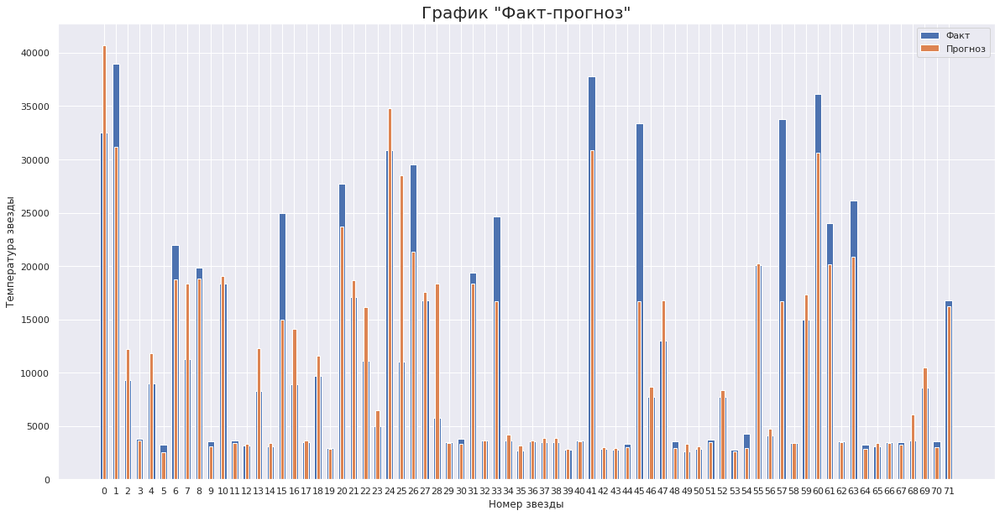

In [57]:
fig,ax = plt.subplots()
fig.set_figwidth(20)
fig.set_figheight(10)
ax.set_xticks(x)
fact = ax.bar(x, y2, width = 0.6, label = 'Факт')
forecast = ax.bar(x, y1, width = 0.3, label = 'Прогноз')
ax.legend()
ax.set_title('График "Факт-прогноз"', fontsize=20)
ax.set_xlabel('Номер звезды')
ax.set_ylabel('Температура звезды')
plt.show()

По графику сравнения фактического значения и предсказания можно сказать, что ошибка есть и она видна. <br>
Особо заметна она на звездах, где значения температуры высоки. <br>
Мое мнение - улучшить результат и уменьшить ошибку можно путем категоризации данных, лучшего перебора гиперпараметров, большего кол-ва времени. 

## Выводы

Подведем итоги проекта. Модель обучилась и достигла нужных результатов ( rmse 4500), а я в свою очередь вдоволь наигрался с перебором гиперпараметров. <br>
Понял общую картину, как лучше всего достигать прогресса в обучении модели. и моё мнение сложилось таким, что перебарщивать с кол-во скрытых слоев нельзя. <br>
Это замедляет работу модели и не дает ощутимого буста метрики на выходе, иногда даже наоборот вредит и ухудшает. <br>
Далее, я перебирая кол-во нейронов в скрытых слоев достиг легкого понимания, что кол-во нейронов в первом скрытом слое не должно быть больше, чем кол-во признаков на входе, а кол-во нейронов в следующих слоях для этой задачи должно уменьшаться. <br>
Возможно, это ложно-сформированное мнение, но на практике показалось, что это именно так и работает. <br>
Касаемо проекта в целом, была проведена загрузка данных, предообработка данных, увидели зависимости различных характеристик звезды на температуру. <br>
Модель предсказывает температуру, но чем выше фактическая температура звезды, тем больше возможна её ошибка. <br>
Работа над проектом мне понравилась и принесла большое удовольствие, однако, недостаток времени (жесткий дедлайн - 12 ноября) не позволили супер сильно углубиться в deep learning. Но приятный след впечатлений таки оставили. 